# F1 Race Data Analysis
This notebook performs a thorough exploratory data analysis on Formula 1 race data retrieved from the F1DataRepository. We'll implement data quality checks, handle mixed data types, analyze distributions, and visualize key relationships in the data.

In [1]:
%%time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy import stats
import re

from db.repositiries.data_repository import F1DataRepository

CPU times: user 338 ms, sys: 23.8 ms, total: 361 ms
Wall time: 360 ms


## 1. Data Loading and Initial Inspection

In [2]:
%%time
# Initialize the repository and load the data
try:
    f1_repo = F1DataRepository()
    race_data = f1_repo.get_all_race_history()
    print(f"Successfully loaded {len(race_data)} race records")
except Exception as e:
    print(f"Error loading data: {e}")
    raise

# Create a checkpoint copy of the original data
race_data_original = race_data.copy()

# Display basic information about the dataset
print("\n--- Dataset Overview ---")
print(f"Shape: {race_data.shape}")
print("\n--- Data Types ---")
print(race_data.dtypes)
print("\n--- Preview ---")
race_data.head()

2025-03-25 11:55:32,559 - db.repositiries.data_repository - DEBUG - Fetching race history data
2025-03-25 11:55:32,702 - security.vault - DEBUG - Successfully authenticated with Vault
2025-03-25 11:55:32,703 - security.vault - INFO - Vault client initialized successfully
2025-03-25 11:55:32,730 - db.connection_pool - INFO - Creating database engine for postgresql+psycopg2 at 10.0.20.18:5432/f1db
2025-03-25 11:55:32,786 - db.connection_pool - DEBUG - Database engine and session factory created successfully
2025-03-25 11:55:32,786 - db.repositiries.data_repository - DEBUG - Executing raw SQL to DataFrame: 
        SELECT 
            races.raceId AS raceId,
            races.circuitId AS circuitId,
            circuits.name AS circuitName,
            races.year AS raceYear,
            races.date AS raceDate,
            races.time AS raceTime,
            races.round AS roundNumber,
            races.url AS raceURL,
            constructors.constructorId AS constructorId,
            c

,raceid,circuitid,circuitname,raceyear,racedate,racetime,roundnumber,raceurl,constructorid,constructorname,...,points,fastestlap,fastestlaptime,fastestlapspeed,drivertotalpoints,driverrank,driverwins,constructortotalpoints,constructorrank,constructorwins
0,257,18,Autódromo José Carlos Pace,1994,1994-03-27,None,1,http://en.wikipedia.org/wiki/1994_Brazilian_Gr...,22,Benetton,...,10.0,NaN,None,None,10.0,1,1.0,10.0,1,1.0
1,257,18,Autódromo José Carlos Pace,1994,1994-03-27,None,1,http://en.wikipedia.org/wiki/1994_Brazilian_Gr...,3,Williams,...,6.0,NaN,None,None,6.0,2,0.0,6.0,2,0.0
2,257,18,Autódromo José Carlos Pace,1994,1994-03-27,None,1,http://en.wikipedia.org/wiki/1994_Brazilian_Gr...,6,Ferrari,...,4.0,NaN,None,None,4.0,3,0.0,4.0,3,0.0
3,257,18,Autódromo José Carlos Pace,1994,1994-03-27,None,1,http://en.wikipedia.org/wiki/1994_Brazilian_Gr...,17,Jordan,...,3.0,NaN,None,None,3.0,4,0.0,3.0,4,0.0
4,257,18,Autódromo José Carlos Pace,1994,1994-03-27,None,1,http://en.wikipedia.org/wiki/1994_Brazilian_Gr...,25,Tyrrell,...,2.0,NaN,None,None,2.0,5,0.0,2.0,5,0.0


## 2. Data Quality Assessment

In this section, we'll check for:
 - Missing values
 - Data types
 - Cardinality of categorical variables
 - Range and distribution of numeric variables

--- Missing Values Analysis ---
                        Missing Count  Missing Percent
q3                               6095        63.655352
milliseconds                     5453        56.950392
q2                               4260        44.490862
racetime                         2228        23.268930
fastestlaptime                   2217        23.154047
fastestlap                       2217        23.154047
fastestlapspeed                  2217        23.154047
drivercode                       1326        13.848564
driverwins                        241         2.516971
drivertotalpoints                 241         2.516971
driverrank                        241         2.516971
q1                                139         1.451697
constructortotalpoints             95         0.992167
constructorwins                    95         0.992167
constructorrank                    95         0.992167


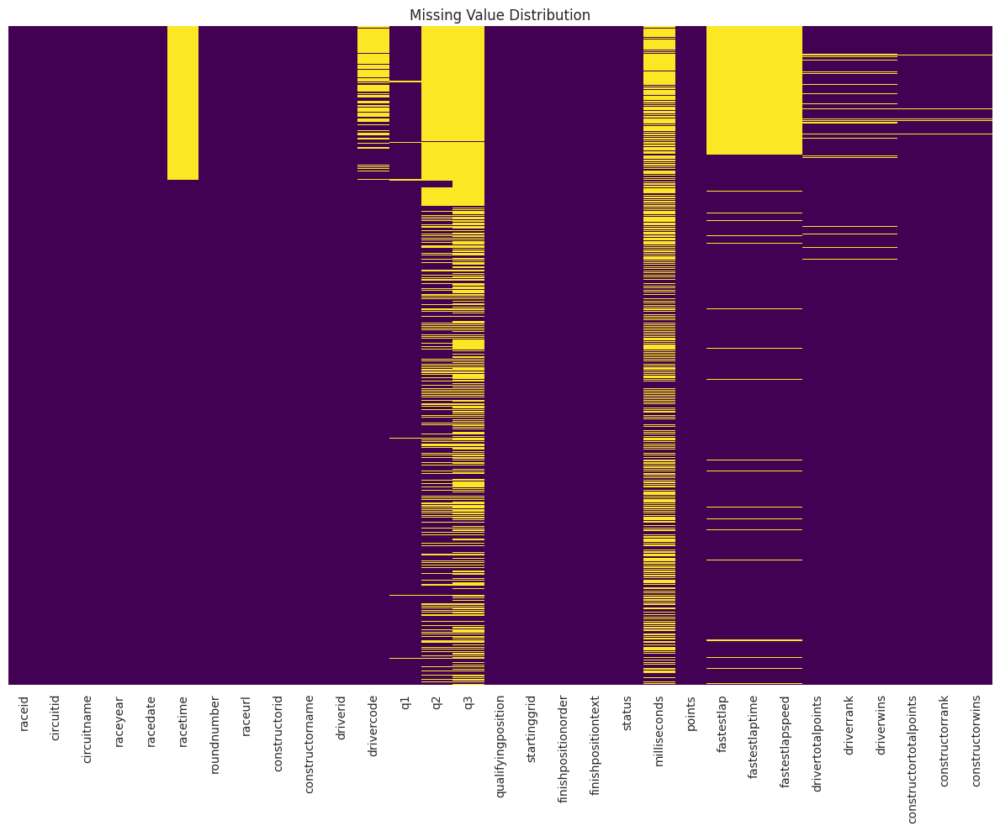

CPU times: user 665 ms, sys: 32.1 ms, total: 697 ms
Wall time: 696 ms


In [3]:
%%time
# Define expected data types based on column names and content
expected_dtypes = {
    'raceId': 'int',
    'circuitId': 'int',
    'circuitName': 'object',
    'raceYear': 'int',
    'raceDate': 'datetime64[ns]',
    'raceTime': 'object',
    'roundNumber': 'int',
    'raceURL': 'object',
    'constructorId': 'int',
    'constructorName': 'object',
    'driverId': 'int',
    'driverCode': 'object',
    'q1': 'object',  # Time format might need custom parsing
    'q2': 'object',  # Time format might need custom parsing
    'q3': 'object',  # Time format might need custom parsing
    'qualifyingPosition': 'int',
    'startingGrid': 'int',
    'finishPositionOrder': 'int',
    'finishPositionText': 'object',
    'status': 'object',
    'milliseconds': 'float',
    'points': 'float',
    'fastestLap': 'object',  # Might contain mixed types
    'fastestLapTime': 'object',  # Time format
    'fastestLapSpeed': 'float',
    'driverTotalPoints': 'float',
    'driverRank': 'object',
    'driverWins': 'int',
    'constructorTotalPoints': 'float',
    'constructorRank': 'object',
    'constructorWins': 'int'
}

# Check missing values
missing_data = race_data.isnull().sum().sort_values(ascending=False)
missing_percent = (race_data.isnull().sum() / len(race_data) * 100).sort_values(ascending=False)

# Create a DataFrame to display missing values
missing_info = pd.concat([missing_data, missing_percent], axis=1,
                         keys=['Missing Count', 'Missing Percent'])
print("--- Missing Values Analysis ---")
print(missing_info[missing_info['Missing Count'] > 0])

# Visualize missing values with a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(race_data.isnull(), cbar=False, yticklabels=False, cmap='viridis')
plt.title('Missing Value Distribution')
plt.tight_layout()
plt.show()

### 2.1 Cardinality Analysis for Categorical Variables

--- Cardinality Analysis ---
                    Unique Values
q1                           8433
fastestlapspeed              6920
fastestlaptime               6752
q2                           4878
q3                           3071
raceurl                       448
racedate                      448
status                        102
drivercode                     92
constructorname                46
circuitname                    42
driverrank                     41
racetime                       33
finishpositiontext             30
constructorrank                15


<Figure size 1200x800 with 0 Axes>

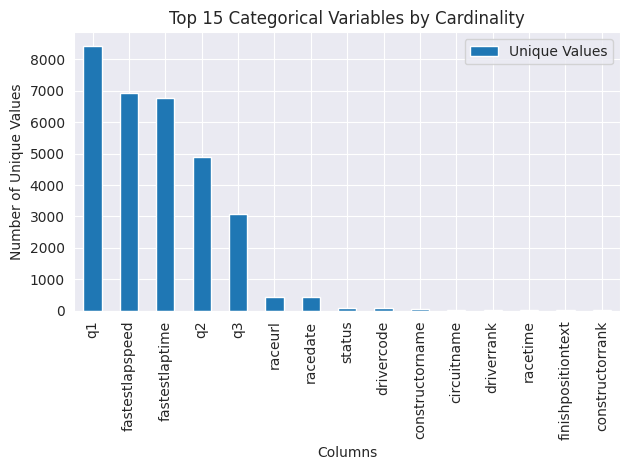

In [4]:
# Identify categorical columns
categorical_columns = [col for col in race_data.columns if race_data[col].dtype == 'object']

# Calculate cardinality for each categorical column
cardinality = {col: race_data[col].nunique() for col in categorical_columns}
cardinality_df = pd.DataFrame.from_dict(cardinality, orient='index', columns=['Unique Values'])
cardinality_df = cardinality_df.sort_values('Unique Values', ascending=False)

print("--- Cardinality Analysis ---")
print(cardinality_df)

# Plot cardinality for top categories
plt.figure(figsize=(12, 8))
cardinality_df.head(15).plot(kind='bar')
plt.title('Top 15 Categorical Variables by Cardinality')
plt.xlabel('Columns')
plt.ylabel('Number of Unique Values')
plt.tight_layout()
plt.show()


### 2.2 Type Validation and Conversion

In [7]:
%%time
# Create a dictionary to track conversion errors
conversion_errors = {}
cleaned_data = race_data.copy()

# Function to convert time string to milliseconds
def time_to_milliseconds(time_str):
    if pd.isna(time_str):
        return np.nan

    # Try different time formats
    try:
        # Format: MM:SS.sss
        if re.match(r'^\d+:\d+\.\d+$', time_str):
            parts = time_str.split(':')
            minutes = int(parts[0])
            seconds_parts = parts[1].split('.')
            seconds = int(seconds_parts[0])
            milliseconds = int(seconds_parts[1].ljust(3, '0')[:3])
            return minutes * 60 * 1000 + seconds * 1000 + milliseconds

        # Format: SS.sss
        elif re.match(r'^\d+\.\d+$', time_str):
            parts = time_str.split('.')
            seconds = int(parts[0])
            milliseconds = int(parts[1].ljust(3, '0')[:3])
            return seconds * 1000 + milliseconds
    except:
        return np.nan

    return np.nan

# Process numeric columns
numeric_columns = [col for col in race_data.columns if
                  expected_dtypes.get(col, 'object').startswith(('int', 'float'))]

for col in numeric_columns:
    try:
        cleaned_data[col], errors = pd.to_numeric(race_data[col], errors='coerce', downcast='integer'), None
        if cleaned_data[col].isna().sum() > race_data[col].isna().sum():
            # Track rows where conversion created new NaNs
            errors = race_data[cleaned_data[col].isna() & ~race_data[col].isna()][col].value_counts()

        if errors is not None and not errors.empty:
            conversion_errors[col] = errors
    except Exception as e:
        print(f"Error converting {col}: {e}")
        conversion_errors[col] = str(e)

# Process special time columns (using the actual lowercase column names)
time_columns = ['q1', 'q2', 'q3', 'fastestlaptime']  # Changed from 'fastestLapTime' to 'fastestlaptime'

for col in time_columns:
    try:
        # Create new column with milliseconds
        new_col = f'{col}_ms'
        cleaned_data[new_col] = cleaned_data[col].apply(time_to_milliseconds)
    except Exception as e:
        print(f"Error converting time column {col}: {e}")

# Process date and time columns (using lowercase column names)
try:
    cleaned_data['racedate'] = pd.to_datetime(cleaned_data['racedate'], errors='coerce')  # Changed from 'raceDate' to 'racedate'

    # Combine date and time for race start
    cleaned_data['racedatetime'] = pd.NaT  # Changed from 'raceDateTime' to 'racedatetime'
    mask = ~cleaned_data['racetime'].isna() & ~cleaned_data['racedate'].isna()  # Changed column names to lowercase
    cleaned_data.loc[mask, 'racedatetime'] = cleaned_data.loc[mask].apply(
        lambda row: pd.Timestamp(f"{row['racedate'].strftime('%Y-%m-%d')} {row['racetime']}"),
        axis=1
    )
except Exception as e:
    print(f"Error processing date/time: {e}")

# Report conversion errors
if conversion_errors:
    print("\n--- Type Conversion Issues ---")
    for col, errors in conversion_errors.items():
        print(f"\nColumn: {col}")
        print(errors)

CPU times: user 394 ms, sys: 0 ns, total: 394 ms
Wall time: 393 ms


### 2.3 Check for Data Consistency

In [11]:
%%time
# Check for consistency between different position columns
position_check = cleaned_data[['qualifyingposition', 'startinggrid', 'finishpositionorder', 'finishpositiontext']]
position_check['finishpositiontext_numeric'] = pd.to_numeric(position_check['finishpositiontext'], errors='coerce')

# Calculate inconsistencies
position_check['qual_vs_grid_diff'] = position_check['qualifyingposition'] - position_check['startinggrid']
position_check['grid_vs_finish_diff'] = position_check['startinggrid'] - position_check['finishpositionorder']
position_check['finishpos_vs_text_diff'] = position_check['finishpositionorder'] - position_check['finishpositiontext_numeric']

# Check for inconsistencies
inconsistencies = position_check[
    (position_check['finishpos_vs_text_diff'] != 0) &
    (~position_check['finishpos_vs_text_diff'].isna())
]

print(f"Found {len(inconsistencies)} inconsistencies between position columns")
if len(inconsistencies) > 0:
    print(inconsistencies.head())

Found 0 inconsistencies between position columns
CPU times: user 16 ms, sys: 0 ns, total: 16 ms
Wall time: 15.3 ms


<timed exec>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<timed exec>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<timed exec>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<timed exec>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slic

## 3. Enhanced Analysis
Now that we've assessed and cleaned the data, let's perform deeper analysis.

### 3.1 Descriptive Statistics for Numeric Variables

In [12]:
# Get descriptive statistics for numeric columns
numeric_data = cleaned_data.select_dtypes(include=['int64', 'float64'])
numeric_stats = numeric_data.describe(percentiles=[.01, .05, .25, .5, .75, .95, .99]).T
numeric_stats['missing'] = cleaned_data[numeric_data.columns].isnull().sum()
numeric_stats['missing_pct'] = cleaned_data[numeric_data.columns].isnull().sum() / len(cleaned_data) * 100

print("--- Numeric Variables Statistics ---")
pd.set_option('display.float_format', '{:.2f}'.format)
numeric_stats

--- Numeric Variables Statistics ---


,count,mean,std,min,1%,5%,25%,50%,75%,95%,99%,max,missing,missing_pct
raceid,9575.00,576.92,418.41,1.00,5.00,24.00,116.50,851.00,972.00,1072.00,1092.00,1096.00,0,0.00
circuitid,9575.00,18.56,19.32,1.00,1.00,1.00,6.00,13.00,21.00,70.00,76.00,79.00,0,0.00
raceyear,9575.00,2010.08,8.06,1994.00,1994.00,1995.00,2005.00,2011.00,2017.00,2021.00,2022.00,2022.00,0,0.00
roundnumber,9575.00,9.66,5.61,1.00,1.00,1.00,5.00,9.00,14.00,19.00,21.00,22.00,0,0.00
constructorid,9575.00,43.52,69.89,1.00,1.00,1.00,4.00,9.00,25.00,210.00,213.00,214.00,0,0.00
driverid,9575.00,303.46,377.39,1.00,1.00,3.00,15.00,49.00,817.00,844.00,852.00,856.00,0,0.00
qualifyingposition,9575.00,11.26,6.30,1.00,1.00,2.00,6.00,11.00,17.00,21.00,24.00,28.00,0,0.00
startinggrid,9575.00,11.15,6.32,0.00,1.00,1.00,6.00,11.00,16.00,21.00,24.00,26.00,0,0.00
finishpositionorder,9575.00,11.28,6.32,1.00,1.00,2.00,6.00,11.00,17.00,21.00,24.00,28.00,0,0.00
milliseconds,4122.00,5857268.13,1116600.91,207071.00,4504574.19,4830947.05,5347085.25,5662560.00,6035623.25,7421719.50,10887461.52,14743144.00,5453,56.95


### 3.2 Outlier Detection

--- Outlier Analysis ---

Column: milliseconds
  IQR method:
    Outliers: 412 (4.30%)
    Bounds: [4314278.25, 7068430.25]
  Z-score method:
    Outliers: 5555 (58.02%)

Column: q1_ms
  IQR method:
    Outliers: 125 (1.31%)
    Bounds: [52917.12, 122562.12]
  Z-score method:
    Outliers: 176 (1.84%)

Column: q2_ms
  IQR method:
    Outliers: 27 (0.28%)
    Bounds: [51067.50, 123987.50]
  Z-score method:
    Outliers: 4433 (46.30%)

Column: q3_ms
  IQR method:
    Outliers: 12 (0.13%)
    Bounds: [49978.00, 124154.00]
  Z-score method:
    Outliers: 6405 (66.89%)

Column: points
  IQR method:
    Outliers: 783 (8.18%)
    Bounds: [-7.50, 12.50]
  Z-score method:
    Outliers: 260 (2.72%)


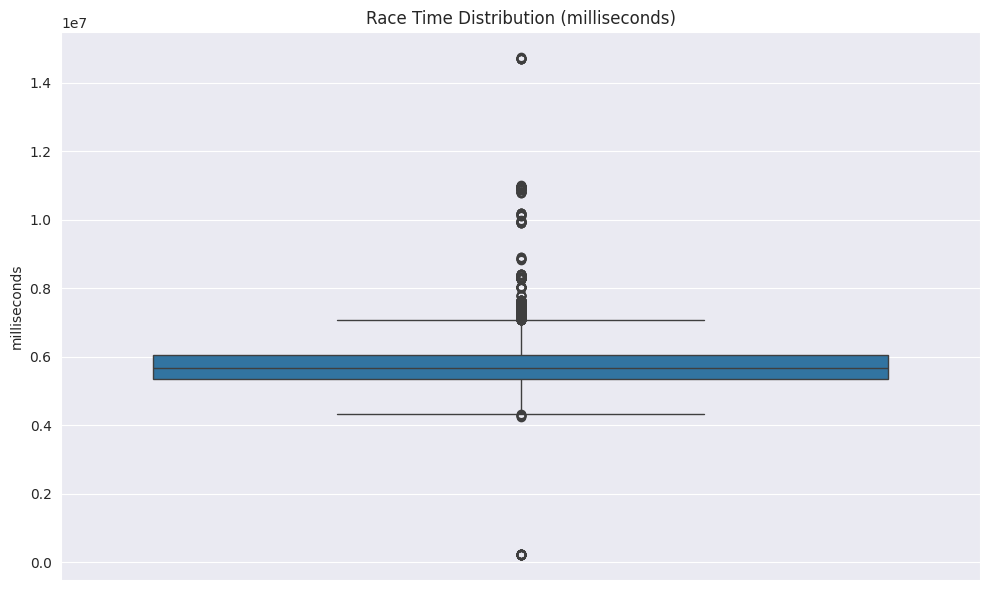

CPU times: user 180 ms, sys: 3.94 ms, total: 184 ms
Wall time: 183 ms


In [13]:
%%time
# Function to detect outliers using IQR method
def detect_outliers_iqr(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    return outliers, lower_bound, upper_bound

# Function to detect outliers using Z-score method
def detect_outliers_zscore(df, column, threshold=3):
    z_scores = stats.zscore(df[column], nan_policy='omit')
    abs_z_scores = np.abs(z_scores)
    filtered_entries = (abs_z_scores < threshold)
    outliers = df[~filtered_entries]
    return outliers

# Numeric columns for outlier detection (focusing on performance metrics)
performance_columns = ['milliseconds', 'q1_ms', 'q2_ms', 'q3_ms', 'fastestLapTime_ms', 'fastestLapSpeed', 'points']
performance_columns = [col for col in performance_columns if col in cleaned_data.columns]

# Create outlier report
outlier_summary = {}
for col in performance_columns:
    if cleaned_data[col].notna().sum() > 0:  # Only check if column has non-null values
        # IQR method
        outliers_iqr, lower, upper = detect_outliers_iqr(cleaned_data, col)
        # Z-score method
        outliers_zscore = detect_outliers_zscore(cleaned_data, col)

        outlier_summary[col] = {
            'IQR': {
                'count': len(outliers_iqr),
                'percentage': len(outliers_iqr) / len(cleaned_data) * 100,
                'bounds': (lower, upper)
            },
            'Z-score': {
                'count': len(outliers_zscore),
                'percentage': len(outliers_zscore) / len(cleaned_data) * 100
            }
        }

# Display outlier summary
print("--- Outlier Analysis ---")
for col, methods in outlier_summary.items():
    print(f"\nColumn: {col}")
    for method, stats in methods.items():
        print(f"  {method} method:")
        print(f"    Outliers: {stats['count']} ({stats['percentage']:.2f}%)")
        if method == 'IQR':
            print(f"    Bounds: [{stats['bounds'][0]:.2f}, {stats['bounds'][1]:.2f}]")

# Visualize outliers for a key performance metric (if available)
if 'milliseconds' in cleaned_data.columns and cleaned_data['milliseconds'].notna().sum() > 0:
    plt.figure(figsize=(10, 6))
    sns.boxplot(y=cleaned_data['milliseconds'])
    plt.title('Race Time Distribution (milliseconds)')
    plt.tight_layout()
    plt.show()

### 3.3 Temporal Analysis

In [18]:
# Analyzing performance trends over time
# Ensure we have proper date information
if 'raceyear' in cleaned_data.columns:
    # Check column names and convert to numeric if needed

    # Ensure column names are consistent and data is numeric
    if 'fastestlapspeed' in cleaned_data.columns:
        # Convert to numeric, coercing errors to NaN
        cleaned_data['fastestlapspeed'] = pd.to_numeric(cleaned_data['fastestlapspeed'], errors='coerce')
    elif 'fastestLapSpeed' in cleaned_data.columns:
        # If column name has different capitalization
        cleaned_data['fastestlapspeed'] = pd.to_numeric(cleaned_data['fastestLapSpeed'], errors='coerce')

    # Do the same for milliseconds column
    if 'milliseconds' in cleaned_data.columns:
        cleaned_data['milliseconds'] = pd.to_numeric(cleaned_data['milliseconds'], errors='coerce')

    # Group by year and calculate average performance metrics
    yearly_stats = cleaned_data.groupby('raceyear').agg({
        'points': 'mean',
        'fastestlapspeed': 'mean',  # Simplified since we converted to numeric
        'milliseconds': 'mean'      # Simplified since we converted to numeric
    }).reset_index()

    # Create a plotly figure for yearly trends
    fig = make_subplots(rows=3, cols=1,
                         subplot_titles=('Average Points per Race',
                                         'Average Fastest Lap Speed (km/h)',
                                         'Average Race Time (ms)'))

    fig.add_trace(
        go.Scatter(x=yearly_stats['raceyear'], y=yearly_stats['points'], mode='lines+markers'),
        row=1, col=1
    )

    fig.add_trace(
        go.Scatter(x=yearly_stats['raceyear'], y=yearly_stats['fastestlapspeed'], mode='lines+markers'),
        row=2, col=1
    )

    fig.add_trace(
        go.Scatter(x=yearly_stats['raceyear'], y=yearly_stats['milliseconds'], mode='lines+markers'),
        row=3, col=1
    )

    fig.update_layout(height=800, width=1000, title_text="F1 Performance Trends Over Time",
                      showlegend=False)
    fig.update_xaxes(tickangle=45)
    fig.show()


### 3.4 Constructor and Driver Performance Analysis

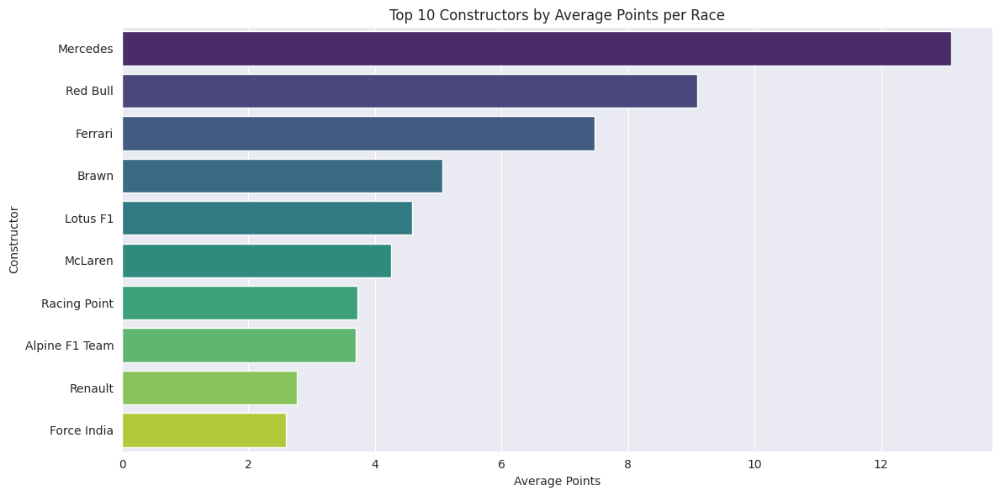

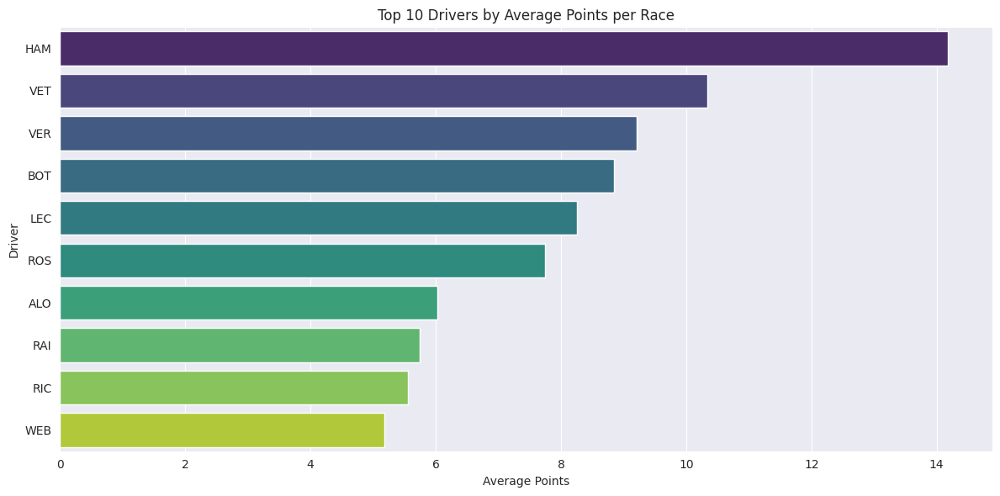

In [26]:
# Analyze top constructors and drivers
if all(col in cleaned_data.columns for col in ['constructorname', 'drivercode', 'points']):
    # Top constructors by average points
    top_constructors = cleaned_data.groupby('constructorname')['points'].agg(['mean', 'count']).sort_values('mean', ascending=False)
    top_constructors = top_constructors[top_constructors['count'] > 10].head(10)  # Filter for constructors with sufficient races

    # Top drivers by average points
    top_drivers = cleaned_data.groupby('drivercode')['points'].agg(['mean', 'count']).sort_values('mean', ascending=False)
    top_drivers = top_drivers[top_drivers['count'] > 10].head(10)  # Filter for drivers with sufficient races

    # Plot top constructors
    plt.figure(figsize=(12, 6))
    sns.barplot(y=top_constructors.index, x=top_constructors['mean'], hue=top_constructors.index, palette='viridis', legend=False)
    plt.title('Top 10 Constructors by Average Points per Race')
    plt.xlabel('Average Points')
    plt.ylabel('Constructor')
    plt.tight_layout()
    plt.show()

    # Plot top drivers
    plt.figure(figsize=(12, 6))
    sns.barplot(y=top_drivers.index, x=top_drivers['mean'], hue=top_drivers.index, palette='viridis', legend=False)
    plt.title('Top 10 Drivers by Average Points per Race')
    plt.xlabel('Average Points')
    plt.ylabel('Driver')
    plt.tight_layout()
    plt.show()

### 3.5 Starting Position vs Finishing Position Analysis

In [22]:
# Analyze how starting position correlates with finishing position
if all(col in cleaned_data.columns for col in ['startinggrid', 'finishpositionorder']):
    # Calculate position changes
    cleaned_data['position_change'] = cleaned_data['startinggrid'] - cleaned_data['finishpositionorder']

    # Group by starting grid and calculate average finish and position change
    grid_analysis = cleaned_data.groupby('startinggrid').agg({
        'finishpositionorder': 'mean',
        'position_change': 'mean',
        'raceid': 'count'  # Count of races for each starting position
    }).reset_index()

    # Rename columns for clarity
    grid_analysis.columns = ['Starting Position', 'Avg Finish Position', 'Avg Position Change', 'Count']

    # Create a plotly figure
    fig = px.scatter(grid_analysis,
                     x='Starting Position',
                     y='Avg Finish Position',
                     size='Count',  # Size of points represents number of races
                     color='Avg Position Change',  # Color based on average position change
                     color_continuous_scale='RdYlGn',  # Red for negative, green for positive
                     title='Starting Position vs. Average Finishing Position',
                     labels={'Avg Position Change': 'Avg Pos Change<br>(+gain, -loss)'},
                     hover_data=['Count'])

    # Add a reference line for y=x (no position change)
    fig.add_trace(
        go.Scatter(x=[1, 20], y=[1, 20], mode='lines', line=dict(color='black', dash='dash'),
                  name='No Position Change')
    )

    fig.update_layout(height=600, width=1000)
    fig.show()

### 3.6 Circuit Analysis

/tmp/ipykernel_95826/362210180.py:18: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




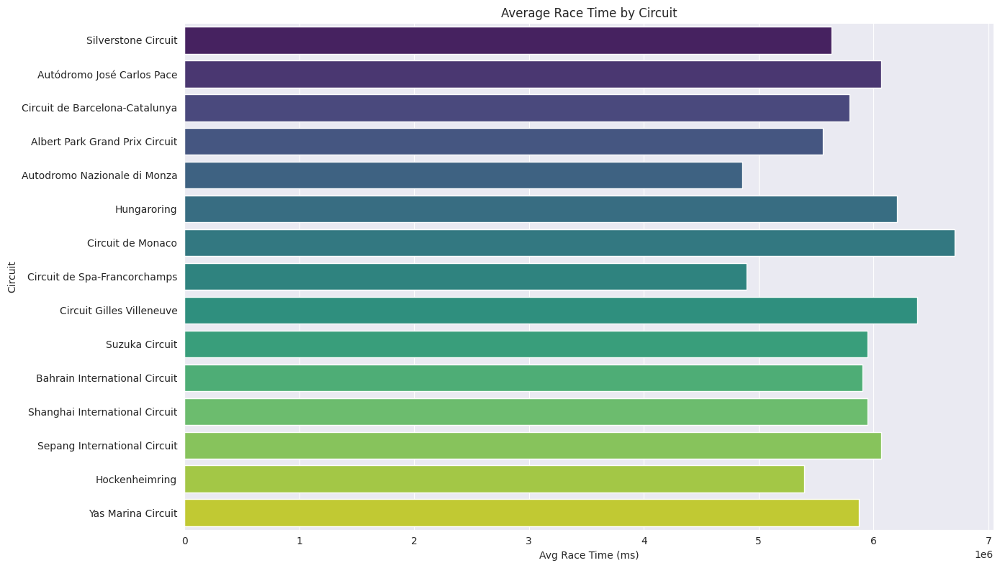

In [28]:
# Analyze performance differences across circuits
if all(col in cleaned_data.columns for col in ['circuitname', 'milliseconds']):
    # Calculate average race time and number of races per circuit
    circuit_analysis = cleaned_data.groupby('circuitname').agg({
        'milliseconds': lambda x: x.mean(skipna=True),
        'raceid': pd.Series.nunique,  # Number of unique races
        'fastestlapspeed': lambda x: x.mean(skipna=True)
    }).reset_index()

    # Sort by number of races (to focus on more established circuits)
    circuit_analysis = circuit_analysis.sort_values('raceid', ascending=False).head(15)

    # Rename columns for clarity
    circuit_analysis.columns = ['Circuit', 'Avg Race Time (ms)', 'Number of Races', 'Avg Fastest Lap Speed']

    # Create a bar chart for race times across circuits
    plt.figure(figsize=(14, 8))
    sns.barplot(y='Circuit', x='Avg Race Time (ms)', data=circuit_analysis, palette='viridis')
    plt.title('Average Race Time by Circuit')
    plt.tight_layout()
    plt.show()

    # Create a scatter plot comparing speed vs. race time by circuit
    fig = px.scatter(circuit_analysis,
                    x='Avg Fastest Lap Speed',
                    y='Avg Race Time (ms)',
                    size='Number of Races',
                    color='Circuit',
                    title='Circuit Comparison: Speed vs. Race Time',
                    hover_name='Circuit')
    fig.update_layout(height=600, width=1000)
    fig.show()


## 4. Correlation Analysis

In [29]:
%%time
# Calculate correlation matrix for numeric variables
corr_columns = [col for col in cleaned_data.columns if
               cleaned_data[col].dtype in ['int64', 'float64'] and
               cleaned_data[col].notna().sum() > 0]  # Only columns with non-null values

# Create correlation matrix with clean column names
correlation_matrix = cleaned_data[corr_columns].corr()

# Create an interactive correlation heatmap with Plotly
fig = px.imshow(correlation_matrix,
                text_auto=True,
                aspect="auto",
                title="Correlation Matrix of F1 Performance Metrics")
fig.update_layout(height=800, width=1000)
fig.show()

# Identify strongest correlations (excluding self-correlations)
corr_pairs = correlation_matrix.unstack()
corr_pairs = corr_pairs[corr_pairs < 1.0]  # Remove self-correlations
strongest_correlations = corr_pairs.abs().sort_values(ascending=False).head(10)

print("--- Strongest Correlations ---")
for idx, corr in strongest_correlations.items():
    print(f"{idx[0]} ↔ {idx[1]}: {corr:.3f}")

--- Strongest Correlations ---
q3_ms ↔ q2_ms: 0.981
q2_ms ↔ q3_ms: 0.981
q1_ms ↔ q2_ms: 0.976
q2_ms ↔ q1_ms: 0.976
constructortotalpoints ↔ drivertotalpoints: 0.962
drivertotalpoints ↔ constructortotalpoints: 0.962
q3_ms ↔ q1_ms: 0.958
q1_ms ↔ q3_ms: 0.958
startinggrid ↔ qualifyingposition: 0.951
qualifyingposition ↔ startinggrid: 0.951
CPU times: user 129 ms, sys: 4.21 ms, total: 133 ms
Wall time: 131 ms


## 5. Advanced Visualization
### 5.1 Multi-variable Analysis

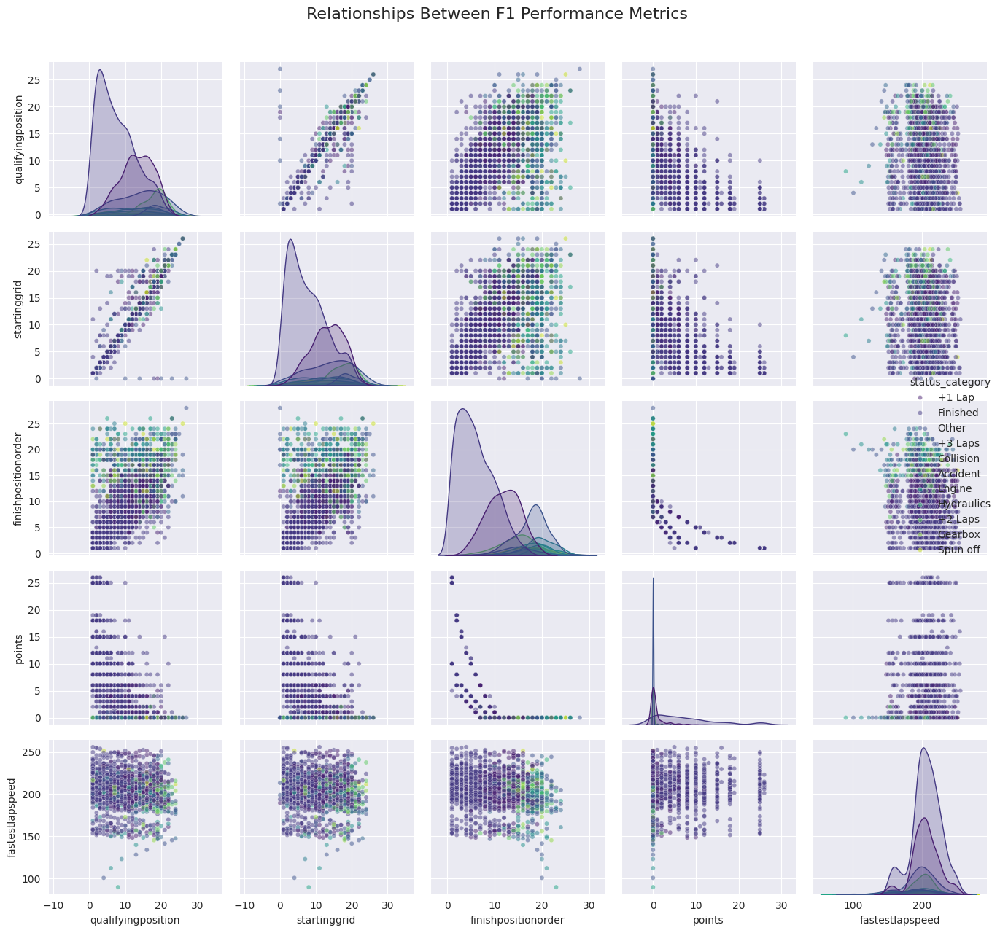

In [30]:
# Select interesting variables for paired analysis
perf_vars = ['qualifyingposition', 'startinggrid', 'finishpositionorder', 'points', 'fastestlapspeed']
perf_vars = [var for var in perf_vars if var in cleaned_data.columns]

# Create a pairplot with seaborn
if len(perf_vars) >= 2:
    # Sample data to avoid overwhelming the plot
    sample_data = cleaned_data.sample(min(2000, len(cleaned_data)))

    # Add a categorical variable for coloring (if available)
    if 'status' in cleaned_data.columns:
        # Focus on key status categories
        status_counts = cleaned_data['status'].value_counts()
        top_statuses = status_counts[status_counts > 100].index.tolist()

        if top_statuses:
            sample_data['status_category'] = sample_data['status'].apply(
                lambda x: x if x in top_statuses else 'Other')

            # Create the pairplot
            g = sns.pairplot(sample_data[perf_vars + ['status_category']],
                             hue='status_category',
                             palette='viridis',
                             diag_kind='kde',
                             plot_kws={'alpha': 0.5, 's': 20})
            g.fig.suptitle('Relationships Between F1 Performance Metrics', y=1.02, fontsize=16)
            plt.tight_layout()
            plt.show()
    else:
        # Create pairplot without hue if status is not available
        g = sns.pairplot(sample_data[perf_vars], palette='viridis', diag_kind='kde')
        g.fig.suptitle('Relationships Between F1 Performance Metrics', y=1.02, fontsize=16)
        plt.tight_layout()
        plt.show()

### 5.2 Driver and Constructor Performance Over Time

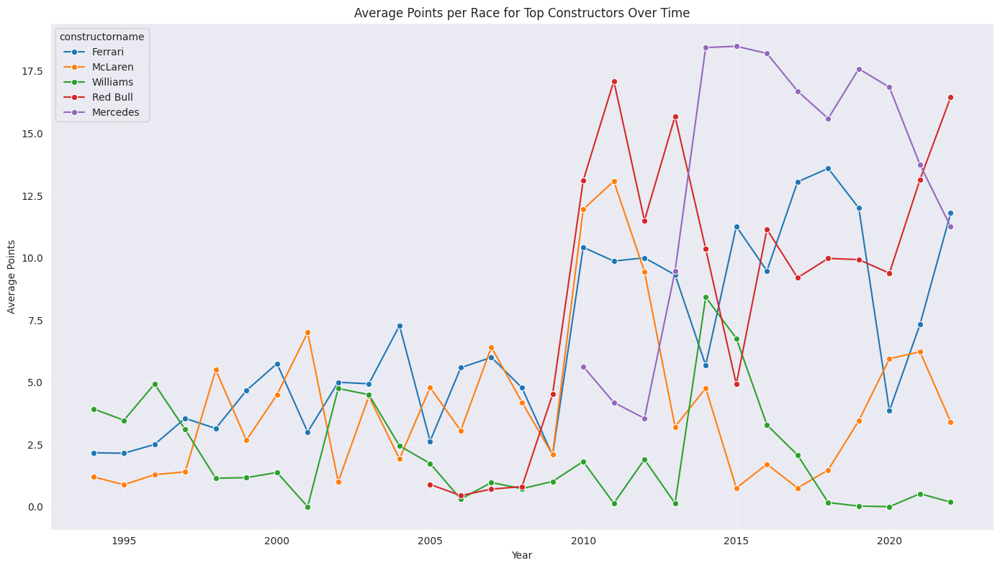

In [32]:
# Analyze performance progression for top drivers/constructors over time
if all(col in cleaned_data.columns for col in ['raceyear', 'constructorname', 'points']):
    # Identify top constructors overall
    top_constructors_overall = cleaned_data.groupby('constructorname')['points'].sum().nlargest(5).index.tolist()

    # Filter for these constructors and create time series
    top_constructor_data = cleaned_data[cleaned_data['constructorname'].isin(top_constructors_overall)]
    constructor_time_series = top_constructor_data.groupby(['raceyear', 'constructorname'])['points'].mean().reset_index()

    # Create time series plot
    plt.figure(figsize=(14, 8))
    sns.lineplot(data=constructor_time_series, x='raceyear', y='points', hue='constructorname', marker='o')
    plt.title('Average Points per Race for Top Constructors Over Time')
    plt.xlabel('Year')
    plt.ylabel('Average Points')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

    # Create interactive Plotly version for more detail
    fig = px.line(constructor_time_series,
                 x='raceyear',
                 y='points',
                 color='constructorname',
                 title='Constructor Performance Evolution',
                 labels={'raceYear': 'Year', 'points': 'Average Points per Race', 'constructorName': 'Constructor'},
                 markers=True)
    fig.update_layout(height=600, width=1000)
    fig.show()

## 6. Validation and Data Cleaning Summary

In [33]:
# Calculate and display data quality metrics
data_quality = {
    'Original rows': len(race_data_original),
    'Cleaned rows': len(cleaned_data),
    'Columns with missing values': sum(cleaned_data.isnull().any()),
    'Total missing values': cleaned_data.isnull().sum().sum(),
    'Missing values percentage': cleaned_data.isnull().sum().sum() / (cleaned_data.shape[0] * cleaned_data.shape[1]) * 100
}

# Check for duplicates
duplicates = cleaned_data.duplicated().sum()
data_quality['Duplicate rows'] = duplicates

# Check data type conversions
dtype_changes = sum(race_data_original.dtypes != cleaned_data.dtypes)
data_quality['Columns with type changes'] = dtype_changes

# Display data quality summary
print("=== Data Quality Summary ===")
for metric, value in data_quality.items():
    if isinstance(value, float):
        print(f"{metric}: {value:.2f}")
    else:
        print(f"{metric}: {value}")

ValueError: Can only compare identically-labeled Series objects

## 7. Final Cleaned Dataset

In [34]:
# Select the most important columns for the cleaned dataset
key_columns = [
    'raceId', 'circuitId', 'circuitName', 'raceYear', 'raceDate', 'raceDateTime',
    'constructorId', 'constructorName', 'driverId', 'driverCode',
    'qualifyingPosition', 'startingGrid', 'finishPositionOrder', 'status',
    'milliseconds', 'points', 'fastestLapSpeed',
    'driverTotalPoints', 'driverRank', 'driverWins',
    'constructorTotalPoints', 'constructorRank', 'constructorWins'
]

# Filter to available columns
final_columns = [col for col in key_columns if col in cleaned_data.columns]

# Create final cleaned dataset
final_data = cleaned_data[final_columns].copy()

# Export cleaned dataset to CSV
# final_data.to_csv('f1_race_data_cleaned.csv', index=False)

# Display final dataset
print(f"Final dataset shape: {final_data.shape}")
final_data.head()

Final dataset shape: (9575, 3)


,status,milliseconds,points
0,Finished,5739200.00,10.00
1,+1 Lap,NaN,6.00
2,+1 Lap,NaN,4.00
3,+1 Lap,NaN,3.00
4,+2 Laps,NaN,2.00
